# Embedding and KNN

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
from sklearn.metrics import accuracy_score
from sklearn.neighbors import KNeighborsRegressor
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras import layers, models, Sequential, Input, Model
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.data.experimental import cardinality
from tensorflow.data.experimental import AUTOTUNE
from tensorflow.keras.models import load_model
import joblib

## Load CNN model

In [2]:
model = load_model('../models/Full_training/20201212_205911_VGG16_v3_27/')
model.summary()

Model: "functional_53"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_54 (InputLayer)        [(None, 224, 224, 3)]     0         
_________________________________________________________________
tf_op_layer_strided_slice_26 (None, 224, 224, 3)       0         
_________________________________________________________________
tf_op_layer_BiasAdd_26 (Tens (None, 224, 224, 3)       0         
_________________________________________________________________
sequential_52 (Sequential)   (None, 400)               24750288  
_________________________________________________________________
dense_53 (Dense)             (None, 12)                4812      
Total params: 24,755,100
Trainable params: 24,755,100
Non-trainable params: 0
_________________________________________________________________


## Embedding calculation of images DB

In [3]:
BATCH_SIZE = 32
IMG_SIZE = (224, 224)

In [4]:
%%time
layer_outputs = [model.layers[-1].input]
embedding_model = models.Model(inputs=model.input, outputs=layer_outputs)

test_dir = r'C:\Users\pitip\OneDrive\Bureau\raw_data\Clean_Data\Test'
img_list = []
for dir_path in os.listdir(test_dir):
    img_list += os.listdir(os.path.join(test_dir, dir_path))
#for root, dirs, files in os.walk(test_dir, topdown=True):
#    for name in files:
#        img_list.append(os.path.join(name))
test_dataset = image_dataset_from_directory(test_dir, shuffle=False, batch_size=BATCH_SIZE, image_size=IMG_SIZE, label_mode='int', 
                                             labels=img_list, interpolation='bilinear')

image_embeddings = embedding_model.predict(test_dataset)
image_embeddings.shape

Found 1390 files belonging to 12 classes.
Wall time: 6min 18s


(1390, 400)

## Fit KNN Regressor on embeddings

In [5]:
knr = KNeighborsRegressor(n_neighbors=1)
knr.fit(image_embeddings, img_list)

KNeighborsRegressor()

## KNN Regressor prediction

In [6]:
test_dir_imext = r'C:\Users\pitip\OneDrive\Bureau\raw_data\Donnees_tests\Données tests'
img_list_imext = []
for dir_path in os.listdir(test_dir_imext):
    img_list_imext += os.listdir(os.path.join(test_dir_imext, dir_path))
test_dataset_imext = image_dataset_from_directory(test_dir_imext, shuffle=False, batch_size=BATCH_SIZE, image_size=IMG_SIZE, label_mode='int', 
                                             labels=img_list_imext, interpolation='bilinear')


print(img_list_imext)
image_embeddings_imext = embedding_model.predict(test_dataset_imext)
image_embeddings_imext.shape

Found 63 files belonging to 8 classes.
['10_1.jpg', '10_2.jpg', '10_3.jpg', '10_4.jpg', '10_5.jpg', '10_6.jpg', '10_7.jpg', '1097_1.jpg', '1097_2.jpg', '1097_3.jpg', '1097_4.jpg', '1097_5.jpg', '1097_6.jpg', '1097_7.jpg', '1097_8.jpg', '1097_9.jpg', '1291_1.jpg', '1291_10.jpg', '1291_11.jpg', '1291_2.jpg', '1291_3.jpg', '1291_4.jpg', '1291_5.jpg', '1291_6.jpg', '1291_7.jpg', '1291_8.jpg', '140_1.jpg', '140_2.jpg', '140_3.jpg', '140_4.jpg', '140_5.jpg', '140_6.jpg', '140_7.jpg', '140_8.jpg', '140_9.jpg', '16_1jpg.jpg', '16_2.jpg', '16_3.jpg', '16_4.jpg', '16_5.jpg', '16_6.jpg', '16_7.jpg', '16_8.jpg', '16_9jpg.jpg', '5f0094b2b66e0_chagall_3-4913938.jpg', 'art_chagall_ba_gb_3d_49247_1510121103_id_1004841.png', 'couverte_chagall_orient_esprit-1-page-001_0.jpg', 'ob_85d129_l1180312cc.JPG', 'xpo_chagall-de-la-palette-au-metier_marc-chagall-dapres-les-arlequins-tapisserie.jpg', 'Yiddishland.jpg', '32688_xl.jpg', '711K+aMaSGL._AC_SX466_.jpg', '71L7b+wAQkL._AC_SL1000_.jpg', 'Detournement-Femme

(63, 400)

In [7]:
for i in range(len(img_list_imext[:3])):
    out = knr.kneighbors(X=image_embeddings_imext[i,:].reshape(1, -1), n_neighbors=3, return_distance=True)
    print(out)

(array([[5.25152794, 5.29027571, 5.47719571]]), array([[515, 596, 604]], dtype=int64))
(array([[5.97681578, 6.04176601, 6.04824653]]), array([[275,   2, 596]], dtype=int64))
(array([[5.56205412, 6.16550341, 6.42133337]]), array([[596, 525, 537]], dtype=int64))


c:\users\pitip\.venvs\lewagon\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


[array([[515, 596, 604]], dtype=int64),
 array([[275,   2, 596]], dtype=int64),
 array([[596, 525, 537]], dtype=int64),
 array([[515,  31, 505]], dtype=int64),
 array([[1019, 1000,  603]], dtype=int64),
 array([[ 650,  222, 1376]], dtype=int64),
 array([[596, 222, 237]], dtype=int64),
 array([[611, 189, 230]], dtype=int64),
 array([[147, 206, 129]], dtype=int64),
 array([[378, 168, 221]], dtype=int64),
 array([[147, 129, 230]], dtype=int64),
 array([[189, 129, 147]], dtype=int64),
 array([[147, 129, 230]], dtype=int64),
 array([[189, 129, 162]], dtype=int64),
 array([[189, 206, 129]], dtype=int64),
 array([[147, 214, 236]], dtype=int64),
 array([[  12, 1316,   47]], dtype=int64),
 array([[888, 552, 421]], dtype=int64),
 array([[519, 507, 535]], dtype=int64),
 array([[1316,   12, 1355]], dtype=int64),
 array([[  84, 1355,   12]], dtype=int64),
 array([[ 707,   12, 1326]], dtype=int64),
 array([[1355,   12,  112]], dtype=int64),
 array([[ 581, 1183, 1245]], dtype=int64),
 array([[46, 56,

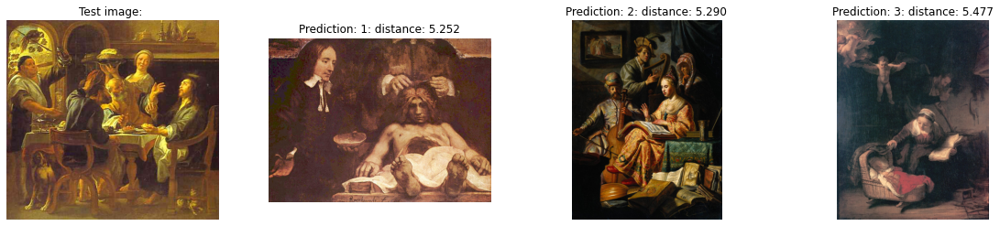

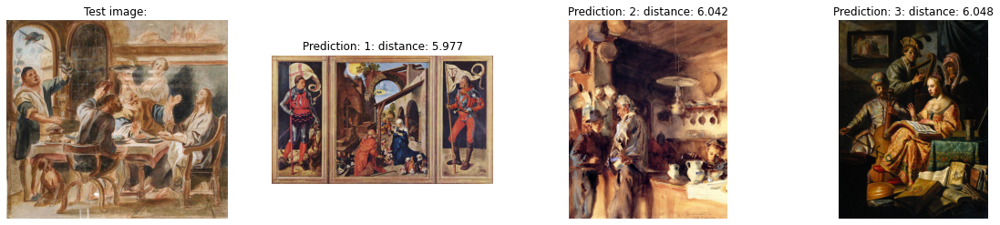

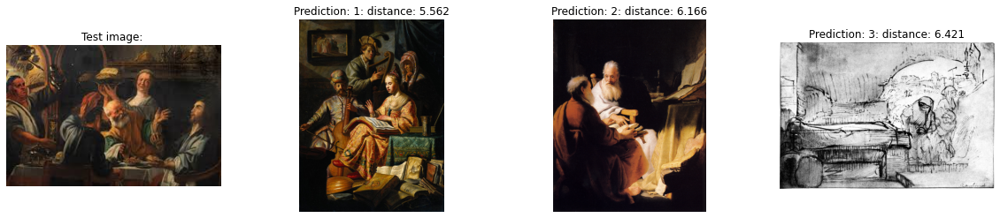

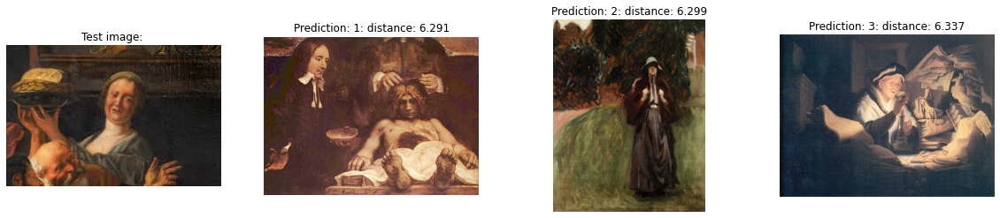

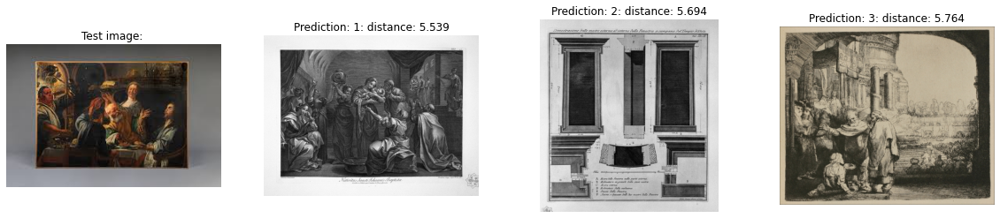

...

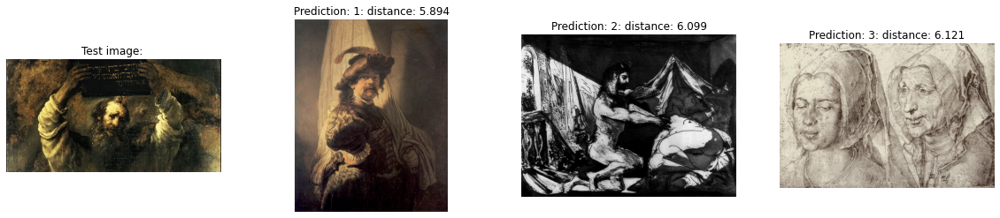

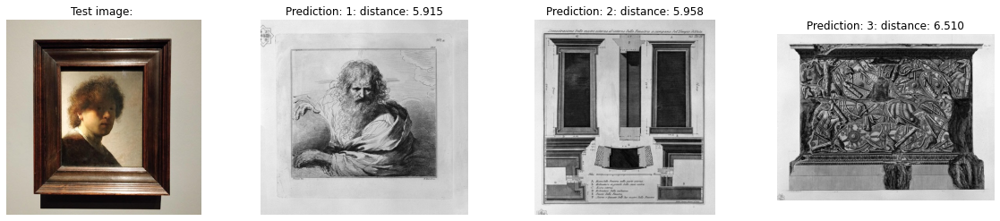

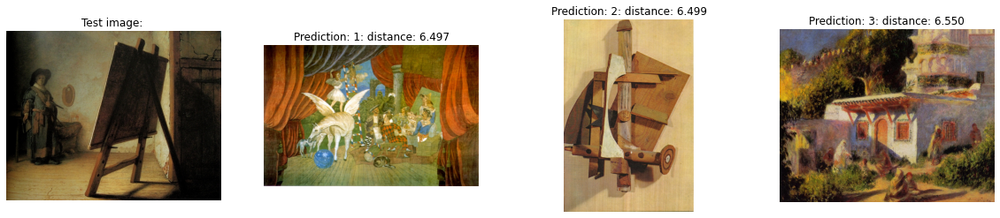

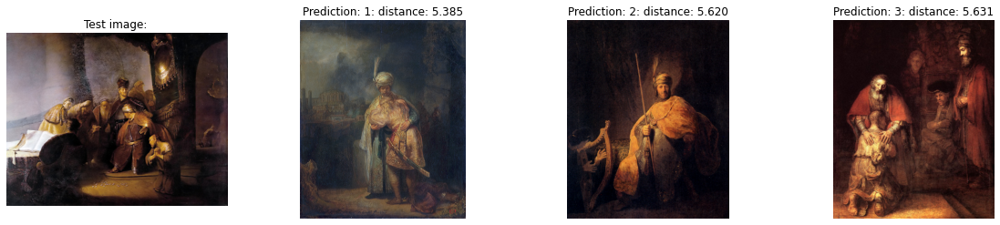

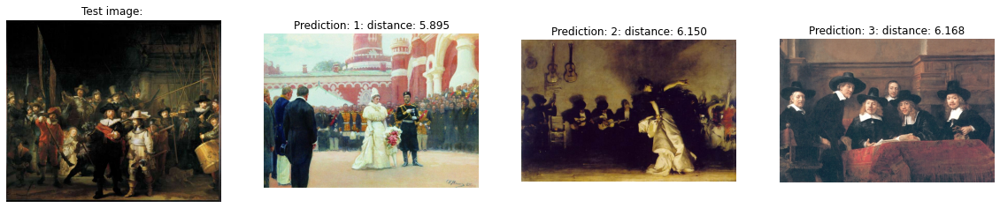

In [8]:
predict_image = []
predict_dist = []
for j in range(len(img_list_imext)):
    fig, ax = plt.subplots(1, 4, figsize=(20,4))
    for path_orig in os.listdir(test_dir_imext):
        path_img_orig = os.path.join(test_dir_imext, path_orig, img_list_imext[j])
        if os.path.isfile(path_img_orig):
            img = plt.imread(path_img_orig)
            ax[0].imshow(img)
            ax[0].axis('off')
            ax[0].set_title('Test image: ')
    
    dist, pred_label = knr.kneighbors(X=image_embeddings_imext[j,:].reshape(1, -1), n_neighbors=3, return_distance=True)
    predict_image.append(pred_label)
    predict_dist.append(dist)
    for i in range(3):
        for k in range(1, 13):
            path_img = os.path.join(test_dir, f"_{k}", img_list[pred_label[0][i]])
            if os.path.isfile(path_img):
                img = plt.imread(os.path.join(test_dir, '_1', path_img))
                ax[i+1].imshow(img)
                ax[i+1].axis('off')
        ax[i+1].set_title(f'Prediction: {i+1}: distance: {dist[0][i]:.3f}')
predict_image

In [9]:
predict_image

[array([[515, 596, 604]], dtype=int64),
 array([[275,   2, 596]], dtype=int64),
 array([[596, 525, 537]], dtype=int64),
 array([[515,  31, 505]], dtype=int64),
 array([[1019, 1000,  603]], dtype=int64),
 array([[ 650,  222, 1376]], dtype=int64),
 array([[596, 222, 237]], dtype=int64),
 array([[611, 189, 230]], dtype=int64),
 array([[147, 206, 129]], dtype=int64),
 array([[378, 168, 221]], dtype=int64),
 array([[147, 129, 230]], dtype=int64),
 array([[189, 129, 147]], dtype=int64),
 array([[147, 129, 230]], dtype=int64),
 array([[189, 129, 162]], dtype=int64),
 array([[189, 206, 129]], dtype=int64),
 array([[147, 214, 236]], dtype=int64),
 array([[  12, 1316,   47]], dtype=int64),
 array([[888, 552, 421]], dtype=int64),
 array([[519, 507, 535]], dtype=int64),
 array([[1316,   12, 1355]], dtype=int64),
 array([[  84, 1355,   12]], dtype=int64),
 array([[ 707,   12, 1326]], dtype=int64),
 array([[1355,   12,  112]], dtype=int64),
 array([[ 581, 1183, 1245]], dtype=int64),
 array([[46, 56,

In [10]:
img_list[predict_image[0][0][0]]

'3094.jpg'

## Save model and reload

In [11]:
joblib.dump(knr, '../models/KNN_models/model2.joblib')

['../models/KNN_models/model2.joblib']

FileNotFoundError: [Errno 2] No such file or directory: 'C:\\Users\\pitip\\OneDrive\\Bureau\\raw_data\\Donnees_tests\\Données tests\\_1\\10_1.jpg'

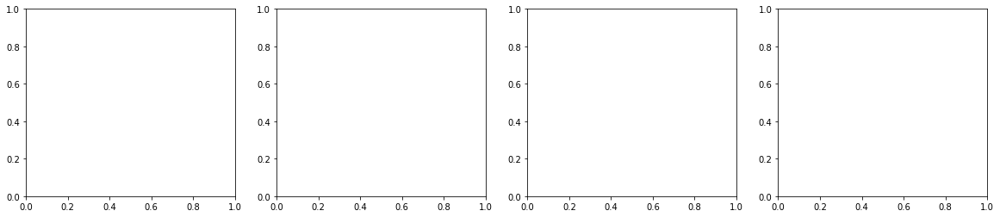

In [12]:
loaded_knr = joblib.load('../models/KNN_models/model2.joblib')
predict_image = []
predict_dist = []
for j in range(len(img_list_imext)):
    fig, ax = plt.subplots(1, 4, figsize=(20,4))
    img = plt.imread(os.path.join(test_dir_imext, '_1', img_list_imext[j]))
    ax[0].imshow(img)
    ax[0].axis('off')
    ax[0].set_title('Test image: ')
    
    dist, pred_label = loaded_knr.kneighbors(X=image_embeddings_imext[j,:].reshape(1, -1), n_neighbors=3, return_distance=True)
    predict_image.append(pred_label)
    predict_dist.append(dist)
    for i in range(3):
        for k in range(1, 13):
            path_img = os.path.join(test_dir, f"_{k}", img_list[pred_label[0][i]])
            if os.path.isfile(path_img):
                img = plt.imread(os.path.join(test_dir, '_1', path_img))
                ax[i+1].imshow(img)
                ax[i+1].axis('off')
        ax[i+1].set_title(f'Prediction: {i+1}: distance: {dist[0][i]:.3f}')
predict_image

In [13]:
image_to_predict = r'C:\Users\pitip\OneDrive\Bureau\raw_data\Donnees_tests\Données tests\Picasso\32688_xl.jpg'
im_li = load_img(image_to_predict, grayscale=False, color_mode='rgb', target_size=(224, 224), interpolation='bilinear')
im_li = np.array(im_li.getdata()).reshape(im_li.size[0], im_li.size[1], 3)
im_li = np.expand_dims(im_li,axis =0)

image_embeddings = embedding_model.predict(im_li)
image_embeddings.shape

(1, 400)

In [15]:
loaded_knr = joblib.load('../models/KNN_models/model2.joblib')
dist, pred_label = loaded_knr.kneighbors(X=image_embeddings.reshape(1, -1), n_neighbors=3, return_distance=True)

In [16]:
pred_label

array([[643, 121, 652]], dtype=int64)

In [17]:
loaded_knr.kneighbors(image_embeddings)

(array([[4.73860815, 5.64188713, 5.65489703, 5.73740881, 5.76384851]]),
 array([[643, 121, 652, 677, 609]], dtype=int64))

In [18]:
loaded_knr

KNeighborsRegressor()

In [21]:
pd.DataFrame(img_list).to_csv(r'../models/KNN_models/img_list_joblib2.csv', index=True)